In [1]:
# Third times the charm
import pandas as pd 
import geopandas as gpd
import folium
import matplotlib.pyplot as plt
import numpy as np
import math
import plotly.express as px

In [2]:
Income = pd.read_excel(
    'Data/Income-Data.xlsx',
    dtype=
    {
        'GEO_ID':str,
    }
)
Income = Income.drop([0])
Income.info

<bound method DataFrame.info of       Geometry       GEO_ID  Less_10k  10k_to_14999  15k_to_19999  20k_24999  \
1     1400000U  06037101110        54           126            49         33   
2     1400000U  06037101122        88             0             7         42   
3     1400000U  06037101220        78            82            28        102   
4     1400000U  06037101221        76           107           118        148   
5     1400000U  06037101222       161           167            34         41   
...        ...          ...       ...           ...           ...        ...   
2494  1400000U  06037980038         0             0             0          0   
2495  1400000U  06037980039         0             0             0          0   
2496  1400000U  06037990100         0             0             0          0   
2497  1400000U  06037990200         0             0             0          0   
2498  1400000U  06037990300         0             0             0          0   

      2

In [3]:
Tracts = gpd.read_file('Data/tl_2021_06_tract.zip')

Tracts1 = Tracts[['GEOID','geometry']]
Tracts1.columns = ['GEO_ID',
'geometry']
Tracts1.head()

ERROR 1: PROJ: proj_create_from_database: Open of /opt/conda/share/proj failed


,GEO_ID,geometry
0,06085504321,"POLYGON ((-121.87556 37.39924, -121.87535 37.3..."
1,06085504410,"POLYGON ((-121.88886 37.40758, -121.88576 37.4..."
2,06085507003,"POLYGON ((-122.02489 37.21683, -122.02459 37.2..."
3,06085507004,"POLYGON ((-121.99304 37.22562, -121.99249 37.2..."
4,06085502204,"POLYGON ((-121.93167 37.29803, -121.92801 37.3..."


In [4]:
District2 = pd.read_excel('Data/District2.xlsx',
    dtype =
    {
        'CT20':str,
    }
)
District2

,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length
0,640,2,640,211000,2110.00,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Westside Planning Area,3.881413e+06,9270.888577
1,641,2,641,211121,2111.21,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,3.125745e+05,2799.117227
2,642,3,642,211122,2111.22,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.341218e+05,3050.487937
3,643,2,643,211123,2111.23,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.513022e+05,2501.035059
4,644,2,644,211124,2111.24,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.771177e+05,3012.923477
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,2484,1,2484,980025,9800.25,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,CARSON,NaN,INCORPORATED CITY,10,South Bay Planning Area,5.660027e+06,12364.180849
502,2486,1,2486,980028,9800.28,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Westside Planning Area,2.867719e+07,31517.576850
503,2487,1,2487,980030,9800.30,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,EL SEGUNDO,NaN,INCORPORATED CITY,5,South Bay Planning Area,7.606368e+06,12791.712010
504,2493,2,2493,980037,9800.37,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,CARSON,NaN,INCORPORATED CITY,11,South Bay Planning Area,1.891289e+06,5551.732493


In [5]:
District2['GEO_ID'] = '06' + '037' + District2['CT20']
District2.head()

,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length,GEO_ID
0,640,2,640,211000,2110.00,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Westside Planning Area,3.881413e+06,9270.888577,06037211000
1,641,2,641,211121,2111.21,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,3.125745e+05,2799.117227,06037211121
2,642,3,642,211122,2111.22,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.341218e+05,3050.487937,06037211122
3,643,2,643,211123,2111.23,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.513022e+05,2501.035059,06037211123
4,644,2,644,211124,2111.24,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.771177e+05,3012.923477,06037211124


In [6]:
District2Tracts=Tracts1.merge(District2,on="GEO_ID")
District2Tracts.head()

,GEO_ID,geometry,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length
0,06037541605,"POLYGON ((-118.21630 33.90339, -118.21538 33.9...",1791,1,1791,541605,5416.05,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,COMPTON,NaN,INCORPORATED CITY,9,Metro Planning Area,1.270111e+06,5153.474133
1,06037542000,"POLYGON ((-118.20734 33.90732, -118.20733 33.9...",1796,2,1796,542000,5420.00,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,COMPTON,EAST RANCHO DOMINGUEZ,INCORPORATED/UNINCORPORATED,9,Metro Planning Area,1.417641e+06,5127.847215
2,06037542401,"POLYGON ((-118.21998 33.89600, -118.21985 33.8...",1802,1,1802,542401,5424.01,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,COMPTON,NaN,INCORPORATED CITY,9,Metro Planning Area,1.881859e+06,5783.777118
3,06037542402,"POLYGON ((-118.21883 33.88859, -118.21868 33.8...",1803,2,1803,542402,5424.02,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,COMPTON,NaN,INCORPORATED CITY,9,Metro Planning Area,2.423799e+06,8444.461398
4,06037542502,"POLYGON ((-118.23599 33.89591, -118.23571 33.8...",1805,1,1805,542502,5425.02,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,COMPTON,NaN,INCORPORATED CITY,9,Metro Planning Area,1.447622e+06,5218.654088


In [7]:
District2TractsGEO=District2Tracts.merge(Income,on="GEO_ID")
District2TractsGEO.head()

,GEO_ID,geometry,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,...,35k_39999,40k_to_44999,45k_to_49999,50k_to_59999,60k_to_74999,75k_to_99999,100k_to_124999,125k_to_149999,150k_to_199999,200k_plus
0,06037541605,"POLYGON ((-118.21630 33.90339, -118.21538 33.9...",1791,1,1791,541605,5416.05,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,...,101,91,32,251,92,186,153,98,11,27
1,06037542000,"POLYGON ((-118.20734 33.90732, -118.20733 33.9...",1796,2,1796,542000,5420.00,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,...,13,55,72,119,146,289,32,99,120,33
2,06037542401,"POLYGON ((-118.21998 33.89600, -118.21985 33.8...",1802,1,1802,542401,5424.01,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,...,21,69,54,142,106,215,179,63,21,38
3,06037542402,"POLYGON ((-118.21883 33.88859, -118.21868 33.8...",1803,2,1803,542402,5424.02,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,...,47,74,17,46,149,135,118,142,45,11
4,06037542502,"POLYGON ((-118.23599 33.89591, -118.23571 33.8...",1805,1,1805,542502,5425.02,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,...,51,87,57,30,211,238,50,10,57,10


In [8]:
# Repeat for District 5
District5 = pd.read_excel('Data/District5.xlsx',
    dtype =
    {
        'CT20':str,
    }
)
District5

,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length
0,1,1,1,101110,1011.10,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,1.676519e+06,5565.411341
1,2,1,2,101122,1011.22,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,3.881001e+06,11695.304277
2,3,1,3,101220,1012.20,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,1.025452e+06,4688.607147
3,4,1,4,101221,1012.21,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,5.197057e+05,3378.824327
4,5,1,5,101222,1012.22,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,4.350619e+05,3685.233312
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
443,2468,2,2468,980009,9800.09,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,Metro Planning Area,3.111583e+07,29917.249730
444,2479,1,2479,980020,9800.20,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,1.251160e+07,22316.623372
445,2480,2,2480,980021,9800.21,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,1.019501e+07,18963.319732
446,2485,1,2485,980026,9800.26,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,1,San Fernando Valley Planning Area,2.040772e+07,37925.072334


In [9]:
District5['GEO_ID'] = '06' + '037' + District5['CT20']
District5.head()

,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length,GEO_ID
0,1,1,1,101110,1011.10,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,1.676519e+06,5565.411341,06037101110
1,2,1,2,101122,1011.22,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,3.881001e+06,11695.304277,06037101122
2,3,1,3,101220,1012.20,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,1.025452e+06,4688.607147,06037101220
3,4,1,4,101221,1012.21,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,5.197057e+05,3378.824327,06037101221
4,5,1,5,101222,1012.22,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,4.350619e+05,3685.233312,06037101222


In [10]:
District5Tracts=Tracts1.merge(District5,on="GEO_ID")
District5Tracts.head()

,GEO_ID,geometry,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length
0,06037311801,"POLYGON ((-118.31214 34.16444, -118.31067 34.1...",1171,1,1171,311801,3118.01,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,BURBANK,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,8.876761e+05,4455.827633
1,06037463800,"POLYGON ((-118.18604 34.13383, -118.18553 34.1...",1500,2,1500,463800,4638.00,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,PASADENA,NaN,INCORPORATED CITY,7,West San Gabriel Valley Planning Area,4.195680e+06,11089.630952
2,06037463900,"POLYGON ((-118.16805 34.12392, -118.16778 34.1...",1501,2,1501,463900,4639.00,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,PASADENA,NaN,INCORPORATED CITY,7,West San Gabriel Valley Planning Area,2.753484e+06,7117.630267
3,06037464000,"POLYGON ((-118.15038 34.13577, -118.14957 34.1...",1502,1,1502,464000,4640.00,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,PASADENA,NaN,INCORPORATED CITY,7,West San Gabriel Valley Planning Area,4.603528e+06,9832.312127
4,06037464200,"POLYGON ((-118.10850 34.13427, -118.10850 34.1...",1505,2,1505,464200,4642.00,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,SAN MARINO,NaN,INCORPORATED CITY,7,West San Gabriel Valley Planning Area,5.062513e+06,9596.189256


In [11]:
District5TractsGEO=District5Tracts.merge(Income,on="GEO_ID")
District5TractsGEO.head()

,GEO_ID,geometry,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,...,35k_39999,40k_to_44999,45k_to_49999,50k_to_59999,60k_to_74999,75k_to_99999,100k_to_124999,125k_to_149999,150k_to_199999,200k_plus
0,06037311801,"POLYGON ((-118.31214 34.16444, -118.31067 34.1...",1171,1,1171,311801,3118.01,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,...,77,95,77,96,94,124,129,108,86,47
1,06037463800,"POLYGON ((-118.18604 34.13383, -118.18553 34.1...",1500,2,1500,463800,4638.00,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,...,24,12,10,34,48,125,86,71,271,650
2,06037463900,"POLYGON ((-118.16805 34.12392, -118.16778 34.1...",1501,2,1501,463900,4639.00,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,...,43,18,0,52,118,144,208,139,166,362
3,06037464000,"POLYGON ((-118.15038 34.13577, -118.14957 34.1...",1502,1,1502,464000,4640.00,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,...,10,10,25,120,300,198,221,259,303,647
4,06037464200,"POLYGON ((-118.10850 34.13427, -118.10850 34.1...",1505,2,1505,464200,4642.00,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,...,53,56,41,65,90,262,100,116,214,754


In [12]:
District2TractsGEO.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [13]:
District5TractsGEO.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [12]:
VulnerableCar = pd.read_excel('Data/Transport.xlsx',
 dtype =
    {
        'TRACT':str,
    }
)
VulnerableCar.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2343 entries, 0 to 2342
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   TRACT      2343 non-null   object 
 1   D2_Transp  2343 non-null   int64  
 2   atmbl_p    2343 non-null   float64
dtypes: float64(1), int64(1), object(1)
memory usage: 55.0+ KB


In [15]:
VulnerableCar.head()

,TRACT,D2_Transp,atmbl_p
0,101110,2,53.753368
1,101122,1,98.986270
2,101210,1,28.538432
3,101220,2,16.745798
4,101300,2,59.707430


In [13]:
VulnerableCar['GEO_ID'] = '06' + '037' + VulnerableCar['TRACT']
VulnerableCar.head()
# make it all match

,TRACT,D2_Transp,atmbl_p,GEO_ID
0,101110,2,53.753368,06037101110
1,101122,1,98.986270,06037101122
2,101210,1,28.538432,06037101210
3,101220,2,16.745798,06037101220
4,101300,2,59.707430,06037101300


<Axes: ylabel='Frequency'>

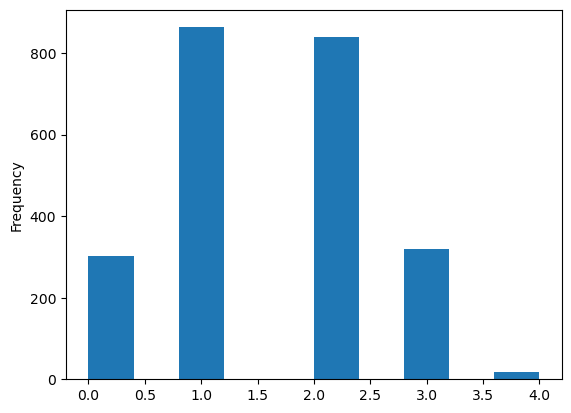

In [17]:
# Histogram of the frequency of D2 Scores
VulnerableCar['D2_Transp'].plot.hist()

In [18]:
CountLA = VulnerableCar.value_counts('D2_Transp').reset_index(name='count')
CountLA
# unique values for LA county for D2_Transp

,D2_Transp,count
0,1,863
1,2,839
2,3,320
3,0,302
4,4,19


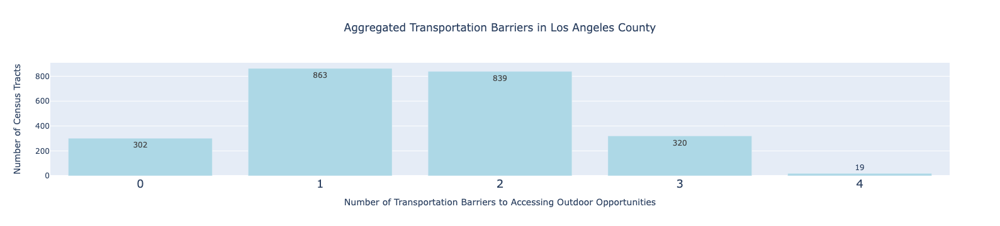

In [19]:
# only 5 options
fig = px.bar(CountLA.head(5),
       x='D2_Transp',
       y='count',
       text='count',  # Use the 'count' column for data labels
       title='Aggregated Transportation Barriers in Los Angeles County',
             labels={
            'D2_Transp':'Number of Transportation Barriers to Accessing Outdoor Opportunities',
            'count':'Number of Census Tracts'})
fig.update_layout(title_x=0.5)
single_color = 'lightblue'  # Dif color, same thing as above
fig.update_traces(marker_color=single_color)
fig.update_layout(xaxis=dict(tickfont=dict(size=18)))
fig.show()

In [20]:
pip install -U kaleido # downloaded this bc the internet said it was the best way to save jpgs

Note: you may need to restart the kernel to use updated packages.


In [21]:
fig.write_image("LA_Barrier.jpg", engine="kaleido")
# Image saved, ignore the error 

In [14]:
District2VulnerableCar=District2TractsGEO.merge(VulnerableCar,on="GEO_ID")
District2VulnerableCar.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 407 entries, 0 to 406
Data columns (total 37 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   GEO_ID          407 non-null    object  
 1   geometry        407 non-null    geometry
 2   OBJECTID_12     407 non-null    int64   
 3   Join_Count      407 non-null    int64   
 4   TARGET_FID      407 non-null    int64   
 5   CT20            407 non-null    object  
 6   LABEL           407 non-null    float64 
 7   NAME            407 non-null    object  
 8   SUP_NAME        407 non-null    object  
 9   DIST_SUP        407 non-null    int64   
 10  CITYNAME_ALF    361 non-null    object  
 11  NAME_1          55 non-null     object  
 12  JURISDICTION    407 non-null    object  
 13  AREA_NUM        407 non-null    int64   
 14  AREA_NAME       407 non-null    object  
 15  Shape__Area     407 non-null    float64 
 16  Shape__Length   407 non-null    float64 
 17  Geometry

<Axes: ylabel='Frequency'>

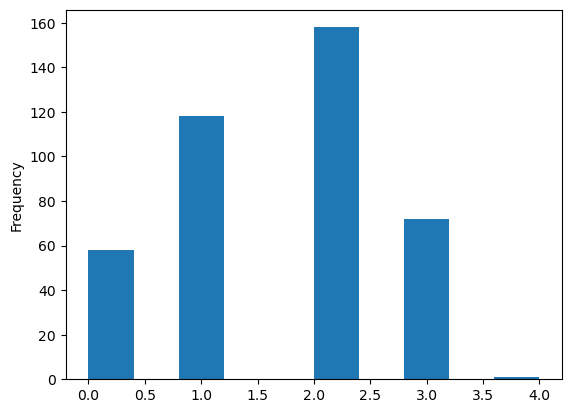

In [23]:
District2VulnerableCar['D2_Transp'].plot.hist()

In [24]:
Count2 = District2VulnerableCar.value_counts('D2_Transp').reset_index(name='count')
Count2

,D2_Transp,count
0,2,158
1,1,118
2,3,72
3,0,58
4,4,1


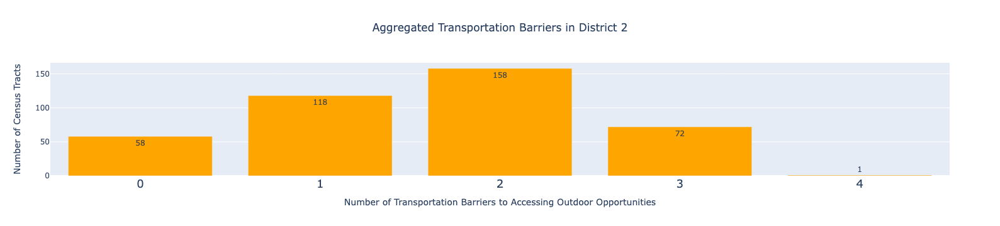

In [25]:
# only 5 options
fig2 = px.bar(Count2.head(5),
       x='D2_Transp',
       y='count',
       text='count',
       title='Aggregated Transportation Barriers in District 2',
        labels={
            'D2_Transp':'Number of Transportation Barriers to Accessing Outdoor Opportunities',
            'count':'Number of Census Tracts'})
fig2.update_layout(title_x=0.5)
single_color2 = 'orange'  # Example: using a color name
fig2.update_traces(marker_color=single_color2)
fig2.update_layout(xaxis=dict(tickfont=dict(size=18)))
fig2.show()

In [26]:
fig2.write_image("D2_Barrier.jpg", engine="kaleido")
# Image saved

In [15]:
District5VulnerableCar=District5TractsGEO.merge(VulnerableCar,on="GEO_ID")
District5VulnerableCar.info()
#final merge to isolate the car data to district 5

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 341 entries, 0 to 340
Data columns (total 37 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   GEO_ID          341 non-null    object  
 1   geometry        341 non-null    geometry
 2   OBJECTID_12     341 non-null    int64   
 3   Join_Count      341 non-null    int64   
 4   TARGET_FID      341 non-null    int64   
 5   CT20            341 non-null    object  
 6   LABEL           341 non-null    float64 
 7   NAME            341 non-null    object  
 8   SUP_NAME        341 non-null    object  
 9   DIST_SUP        341 non-null    int64   
 10  CITYNAME_ALF    294 non-null    object  
 11  NAME_1          54 non-null     object  
 12  JURISDICTION    341 non-null    object  
 13  AREA_NUM        341 non-null    int64   
 14  AREA_NAME       341 non-null    object  
 15  Shape__Area     341 non-null    float64 
 16  Shape__Length   341 non-null    float64 
 17  Geometry

<Axes: title={'center': 'Aggregated Transportation Barriers in District 5'}, ylabel='Frequency'>

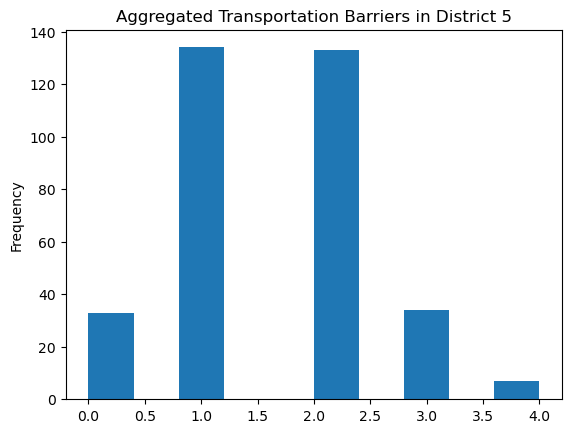

In [28]:
District5VulnerableCar['D2_Transp'].plot.hist(
    title='Aggregated Transportation Barriers in District 5',
    x='Transportation Barriers',)

In [29]:
Count5 = District5VulnerableCar.value_counts('D2_Transp').reset_index(name='count')
Count5
# create a chart for counting the number of values in D2_transp for District 5

,D2_Transp,count
0,1,134
1,2,133
2,3,34
3,0,33
4,4,7


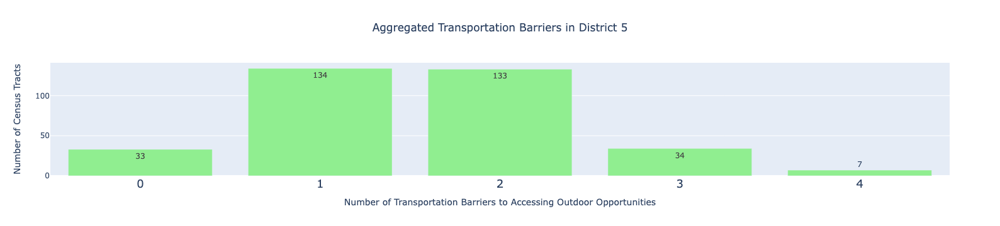

In [30]:
# only 5 options
fig5 = px.bar(Count5.head(5),
       x='D2_Transp',
       y='count',
       text='count',
       title='Aggregated Transportation Barriers in District 5',
        labels={
            'D2_Transp':'Number of Transportation Barriers to Accessing Outdoor Opportunities',
            'count':'Number of Census Tracts'}
            )
single_color5 = 'lightgreen'  # making a variable. idk why the internet said so 
fig5.update_traces(marker_color=single_color5) #coloring the markers
fig5.update_layout(xaxis=dict(tickfont=dict(size=18))) #make the x axis labels bigger
fig5.update_layout(title_x=0.5) #center the title
fig5.show()

In [31]:
fig5.write_image("D5_Barrier.jpg", engine="kaleido")
# Image saved

In [32]:
District5VulnerableCar.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [16]:
Parks = gpd.read_file('Data/Countywide_Parks_and_Open_Space_(Public_-_Hosted).geojson')
Parks.head()
#import park data

,OBJECTID,UNIT_ID,LMS_ID,PARK_NAME,PARK_LBL,ACCESS_TYP,RPT_ACRES,GIS_ACRES,AGNCY_NAME,AGNCY_LEV,...,CENTER_LON,ADDRESS,CITY,ZIP,HOURS,PHONES,IS_COUNTY,Shape__Area,Shape__Length,geometry
0,1,30.0,23603.0,El Barrio Park,El Barrio Park,Open Access,2.093,2.092992,"Claremont, City of",City,...,-117.704423,400 Claremont Blvd,Claremont,91711,None,None,No,9.117036e+04,1451.547906,"POLYGON ((-117.70383 34.09747, -117.70421 34.0..."
1,2,56.0,NaN,El Dorado Park,El Dorado Park,Open Access,5.144,5.143217,"Lancaster, City of",City,...,-118.122109,44501 5th St E,Lancaster,93535,None,None,No,2.240376e+05,2192.277128,"POLYGON ((-118.12252 34.69275, -118.12252 34.6..."
2,3,62.0,3000015.0,Atlantic Avenue Park,Atlantic Avenue Park,Open Access,1.960,1.959610,"Los Angeles, County of",County,...,-118.155201,570 S. Atlantic Blvd.,Los Angeles,90022,March 1st to October 31st<br>\nOperating Hours...,General/Aquatics: (323) 260-2341; Reservations...,Yes,8.536029e+04,1139.269960,"POLYGON ((-118.15541 34.02582, -118.15540 34.0..."
3,4,72.0,22715.0,El Escorpion Park,El Escorpion Park,Open Access,66.914,66.338029,"Los Angeles, City of",City,...,-118.664169,6801 Sunset Ridge Ct,West Hills,91307,None,(818) 883-6641,No,2.889673e+06,7761.831975,"POLYGON ((-118.66713 34.19881, -118.66714 34.1..."
4,5,78.0,22860.0,El Marino Park/ El Marino Elementary,El Marino Park Elementary/El Marino Park,Open Access,3.200,1.650439,"Culver City, City of",City,...,-118.399233,11450 Port Rd,Culver City,90230,None,None,No,7.189283e+04,1215.415276,"POLYGON ((-118.39909 33.99221, -118.39910 33.9..."


In [17]:
Parks['Score'] = (Parks['TOTAL_GOOD'] + (Parks['TOTAL_FAIR']*.5) )/(Parks['TOTAL_GOOD'] + Parks['TOTAL_FAIR'] + Parks['TOTAL_POOR'])

print(Parks)
#Our formula for how good a park is

      OBJECTID   UNIT_ID     LMS_ID  \
0            1      30.0    23603.0   
1            2      56.0        NaN   
2            3      62.0  3000015.0   
3            4      72.0    22715.0   
4            5      78.0    22860.0   
...        ...       ...        ...   
3007      3009    6970.0  3000052.0   
3008      3010    6229.0  3000074.0   
3009      3011  100023.0  3000071.0   
3010      3012    7277.0  3000064.0   
3011      3013       NaN        NaN   

                                        PARK_NAME  \
0                                  El Barrio Park   
1                                  El Dorado Park   
2                            Atlantic Avenue Park   
3                               El Escorpion Park   
4            El Marino Park/ El Marino Elementary   
...                                           ...   
3007  Eaton Canyon Natural Area and Nature Center   
3008       Earvin "Magic" Johnson Recreation Area   
3009                               Hollywood Bowl   
3

In [18]:
Parks['Score'].fillna(0, inplace=True) #replace all null scores

In [19]:
Parks['Score'] 

0       0.500000
1       0.600000
2       0.857143
3       0.000000
4       0.500000
          ...   
3007    0.000000
3008    0.000000
3009    0.000000
3010    0.312500
3011    0.000000
Name: Score, Length: 3012, dtype: float64

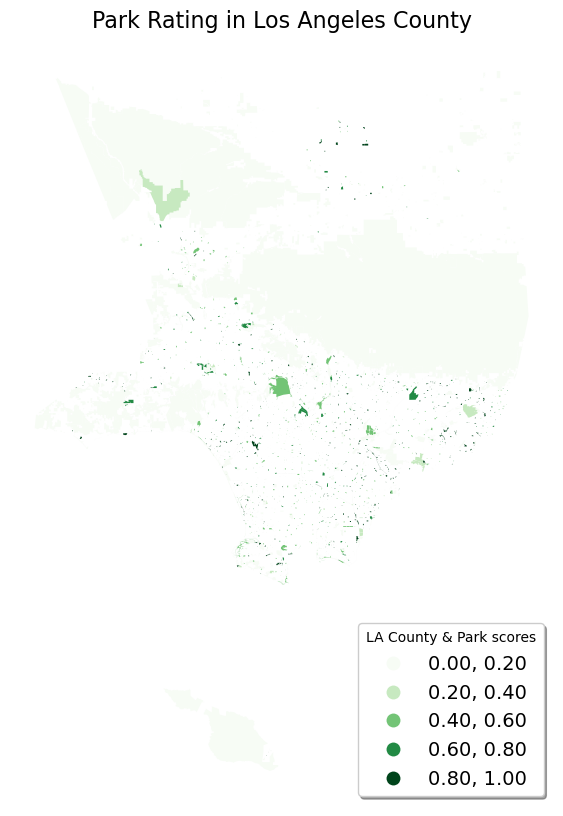

In [26]:
ParkScoreMap = Parks.plot(figsize=(12, 10),
                column='Score',
                legend=True,
                scheme='equal_interval',
                legend_kwds={'title': 'LA County & Park scores',  # Set the title of the legend
                             'fontsize': 14,         # Set the font size of the legend
                             'shadow': True,         # Enable shadow for the legend
                             'loc': 'lower right'},
                cmap='Greens')
ParkScoreMap.set_facecolor('lightgray')
ParkScoreMap.set_title('Park Rating in Los Angeles County',fontsize=16)
ParkScoreMap.axis('off')
# Save the plot to an image file
plt.savefig('parks_score_plot.png', bbox_inches='tight')

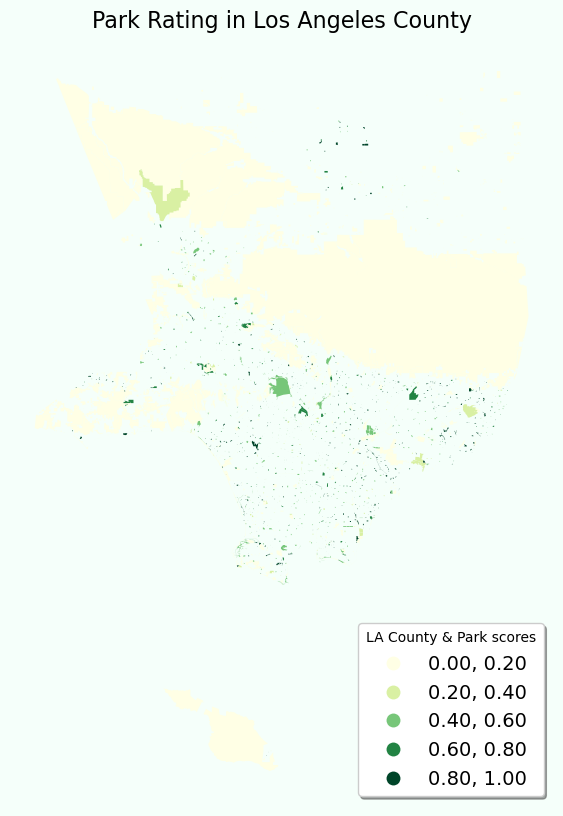

In [35]:
fig, ax = plt.subplots(figsize=(12, 10))

# Set the background color
fig.set_facecolor('mintcream')

# Plot the GeoDataFrame
Parks.plot(column='Score', legend=True, scheme='equal_interval',legend_kwds={'title': 'LA County & Park scores',  # Set the title of the legend
                             'fontsize': 14,         # Set the font size of the legend
                             'shadow': True,         # Enable shadow for the legend
                             'loc': 'lower right'}, cmap='YlGn', ax=ax)

# Set the title
ax.set_title('Park Rating in Los Angeles County', fontsize=16)

# Turn off the axis
ax.axis('off')

# Save the plot to an image file
plt.savefig('parks_score_plot.png', bbox_inches='tight')

In [38]:
District2VulnerableCar.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [39]:
District5VulnerableCar.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [19]:
Parks1 = Parks.to_crs(epsg=4269)
Parks1.crs
# Match the CRS's

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [41]:
print(Parks1.head())

   OBJECTID  UNIT_ID     LMS_ID                             PARK_NAME  \
0         1     30.0    23603.0                        El Barrio Park   
1         2     56.0        NaN                        El Dorado Park   
2         3     62.0  3000015.0                  Atlantic Avenue Park   
3         4     72.0    22715.0                     El Escorpion Park   
4         5     78.0    22860.0  El Marino Park/ El Marino Elementary   

                                   PARK_LBL   ACCESS_TYP  RPT_ACRES  \
0                            El Barrio Park  Open Access      2.093   
1                            El Dorado Park  Open Access      5.144   
2                      Atlantic Avenue Park  Open Access      1.960   
3                         El Escorpion Park  Open Access     66.914   
4  El Marino Park Elementary/El Marino Park  Open Access      3.200   

   GIS_ACRES              AGNCY_NAME AGNCY_LEV  ...                ADDRESS  \
0   2.092992      Claremont, City of      City  ...     

In [20]:
Parks1['Scaled_Score'] = Parks1['Score'] * 100

In [ ]:
%%time
m = folium.Map(location=[34.2,-118.2], 
               zoom_start = 9,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# plot chorpleth 

folium.Choropleth(
    geo_data=District5VulnerableCar,
    data=District5VulnerableCar,
    key_on='feature.properties.GEO_ID',
    columns=['GEO_ID','D2_Transp'],
    fill_color='YlGnBu',
    line_weight=0.1, 
    fill_opacity=0.8,
    line_opacity=0.2,
    legend_name='Transportation Barriers').add_to(m)

folium.Choropleth(
    geo_data=District2VulnerableCar,
    data=District2VulnerableCar,
    key_on='feature.properties.GEO_ID',
    columns=['GEO_ID','D2_Transp'],
    fill_color='YlGnBu',
    line_weight=0.1, 
    fill_opacity=0.8,
    line_opacity=0.2).add_to(m)  

folium.Choropleth(
                  geo_data=Parks1, # geo data
                  data=Parks1,         # data           # key, or merge column
                  columns=['OBJECTID', 'Scaled_Score'], # [key, value]
                  fill_color='YlGnBu',
                  line_weight=0.1, 
                  fill_opacity=0.8,
                  line_opacity=0.2 
                  ).add_to(m)    

m
# I cannot figure out how to remove the second legend. UGH 

CPU times: user 8.21 s, sys: 296 ms, total: 8.51 s
Wall time: 8.76 s


In [ ]:
m.save('D2_5MAP.html')

In [ ]:
from branca.colormap import LinearColormap
o = folium.Map(location=[34.346285, -118.145513], 
               zoom_start=10,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# Add a title to the HTML output of the map
title_html = '<h3 align="center" style="font-size:20px"><b>Transportation Barriers to Accessing Outdoor Opportunities in District 5</b></h3>'
o.get_root().html.add_child(folium.Element(title_html))

colormap = LinearColormap(colors=['green', 'orange'], vmin=District5VulnerableCar['D2_Transp'].min(), vmax=District5VulnerableCar['D2_Transp'].max())

o.add_child(colormap)

folium.GeoJson(
    data=District5VulnerableCar,
    name='geojson',
    style_function=lambda feature: {
        'fillColor': colormap(feature['properties']['D2_Transp']),
        'color': 'black',
        'weight': 0.1,
        'fillOpacity': 0.8
    },
    highlight_function=lambda x: {'weight': 2, 'color': 'black'},
    popup=folium.GeoJsonPopup(fields=['GEO_ID', 'D2_Transp'], aliases=['Census Tract', 'Transportation Barrier Score'], labels=True, sticky=True),
    tooltip='Click for more info'
).add_to(o)

folium.Choropleth(
    geo_data=Parks1,
    data=Parks1,
    columns=['OBJECTID', 'Scaled_Score'],
    fill_color='YlGnBu',
    line_weight=0.1, 
    fill_opacity=1,
    line_opacity=0.2
).add_to(o)

o

In [ ]:
o.save('District5Map.html')

In [23]:
from branca.colormap import LinearColormap
n = folium.Map(location=[33.952874, -118.317719], 
               zoom_start=11.3,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# Add a title to the HTML output of the map
title_html = '<h3 align="center" style="font-size:20px"><b>Transportation Barriers to Accessing Outdoor Opportunities in Supervisorial District 2</b></h3>'
n.get_root().html.add_child(folium.Element(title_html))

colormap = LinearColormap(colors=['green', 'orange'], vmin=District2VulnerableCar['D2_Transp'].min(), vmax=District2VulnerableCar['D2_Transp'].max())

n.add_child(colormap)

folium.GeoJson(
    data=District2VulnerableCar,
    name='geojson',
    style_function=lambda feature: {
        'fillColor': colormap(feature['properties']['D2_Transp']),
        'color': 'black',
        'weight': 0.1,
        'fillOpacity': 0.8
    },
    highlight_function=lambda x: {'weight': 2, 'color': 'black'},
    popup=folium.GeoJsonPopup(fields=['GEO_ID', 'D2_Transp'], aliases=['Census Tract', 'Transportation Barrier Score'], labels=True, sticky=True),
    tooltip='Click for more info'
).add_to(n)

folium.Choropleth(
    geo_data=Parks1,
    data=Parks1,
    columns=['OBJECTID', 'Scaled_Score'],
    fill_color='YlGnBu',
    line_weight=0.1, 
    fill_opacity=1,
    line_opacity=0.2
).add_to(n)

n

In [24]:
n.save('District2Map.html')